# Analyzing & Visualizing NextGen Reads with Magic-BLAST

This Jupyter Notebook contains the background and instructions for the hands-on exercises of this workshop:

* [Introduction](#Introduction)
* [Objective 0 - Introduction to our computing environment and software packages](#Objective-0)
* [Objective 1 - Aligning DNA-seq for SARS-CoV-2 to the reference genome tp identify sequence changes.](#Objective-1) 
* [Objective 2 -  Finding expressed genes on a whole-genome shotgun sequence using mRNA annotation from a related species](#Objective-2)
* [Objective 3 - Align RNAseq data to reference and visualize transcript coverage and diversity](#Objective-3)
* [Conclusions and Further Reading](#Conclusions) 

# Introduction

**Placeholder Text from Webpage**: Next generation sequencing (next-gen) has become the standard method for obtaining genomic and transcriptomic sequences; however analysis of the large number of short reads can be complicated and requires specialized software.  NCBI has developed a variation of the BLAST algorithm, Magic-BLAST, to align next-gen reads to a reference nucleotide sequence.  You can import the read alignment results from Magic-BLAST into one of NCBI’s genome browsers to visualize them alongside your choice of hundreds of other NCBI annotation tracks.  Thus, without having to go through a sequence assembly step, you can quickly assess the sequence set for genetic variations and map potential gene annotations.

This workshop is designed for researchers already working with next-gen data and performing DNAseq or RNAseq experiments who use command-line tools for bioinformatic analysis. 

# Objective 0 - Introduction to our computing environment and software packages <a class="anchor" id="Objective-0"></a>

## Introduction to Jupyter Notebooks 

Jupyter Notebooks are a web-based approach to interactive code. A single notebook (the file you are currently reading) is composed of many "cells" which can contain either text, or code. To navigate between cells, either click, or use the arrow keys on your keyboard.

A text cell will look like... well... this! While a code cell will look something like what you see below. To run the code inside a code cell, click on it, then click the "Run" button at the top of the screen. Try it on the code cell below!

In [5]:
echo "This is a code cell!"

This is a code cell!


If it worked, you should have seen text pop up underneath the cell saying `This is a code cell!`. Note the `In [1]:` that appeared next to the cell. This tells you the order you have run code cells throughout the notebook. The next time you run a code cell, it will say `In [2]:`, then `In [3]:` and so on... This will help you know if/when code has been run.

The remainder of the notebook below has been pre-built by the workshop organizer. You will not need to create any new cells, and you will be explicitly told if/when to execute a code cell, all of which are Bash commands. If you are not familiar with code, don't feel pressured to interpret it very deeply. Descriptions of each code block will be provided!

Enjoy!

## What is MagicBLAST?

MagicBLAST is a BLAST-based short read (next-gen) aligner . It can align DNA-seq and RNA-seq reads to a genome or a transcriptome. Unlike other short read aligners MagicBLAST doesn't require indexing of the database, but searches a BLAST database made from the target reference.  MagicBLAST also offers the following capabilities
- Takes advantage of paired read information when mapping reads
- Recognizes and uses splice site signals when aligning RNA-seq to genomes and can accurately find introns
- Retrieves short read data from NCBI's Sequence Read Archive (SRA) from the NCBI site of from locations in the cloud
- Works with local next-gen data in many common formats
- Produces alignment output in both SAM and human-readable tabular formats
- Performs better than other aligners on next-gen long reads such as those produced by PacBio 

The MagicBLAST publication has details on performance amd comparisons to other popular short-read aligners.

Boratyn GM, Thierry-Mieg J, Thierry-Mieg D, Busby B, Madden TL. (2019) **Magic-BLAST, an accurate RNA-seq aligner for long and short reads.** 
*BMC Bioinformatics* 20: 405.\[[article](https://bmcbioinformatics.biomedcentral.com/articles/10.1186/s12859-019-2996-x)\] 

Visit the [GitHub repository](https://ncbi.github.io/magicblast/) for additional details on usage and command-line options.


---
**Try it out!** You can test run the magicblast application and see all options by executing the command-line in the following cell.

In [ ]:
magicblast -help

A typical MagicBLAST command-line would be

magicblast **-query/-sra** \[file/SRA run accession\] **-db** \[reference genome/transcriptome BLAST database\] \\  
**-reftype** \[genome/transcriptome\] (-paired) (-splice \[true/false\]) (-no_unaligned) (-limit_lookup \[true/false\]) -outfmt \[sam/tabular\]


**-query or -sra**  The next-gen reads to align to the reference genome or transcriptome. The -sra option pulls these using the SRA run accession from NCBI.  
**-db** The reference genome or transcriptome as a BLAST database. You can generate a BLAST database from a FASTA sequence file using the BLAST utility makeblastdb, which is also installed on this environment.  
**-reftype** Specify whether the reference is a genome or a transcriptome. This option sets the **-spliced** option and the **-limit_lookup** to false if transcriptome is selected.   
&nbsp;&nbsp;&nbsp;**-spliced** Indicate whether the program should break alignments across splice junctions. Set to false for transcriptome or prokaryotic genome.  
&nbsp;&nbsp;&nbsp;**-limit_lookup** limits lookup for for word matches that occur more that ten times. Helps to avoid matches to repeats. Set to false for transcriptome.  
**-paired** Indicate if the next-gen reads are paired.  
**-no_unaligned** Excludes reads with no alignment from the output.    
**-outfmt** Choose output format: tabular, a human readable tab-delimited output, or Sequence Alignment/Map (SAM), which can be processed and reformatted by **samtools** and **bedtools**, also installed on this Jupyter hub.  


---
## Objective 1. Aligning DNA-seq for SARS-CoV-2 to the reference genome to identify sequence changes. <a class="anchor" id="Objective-1"></a> 
### Step 1 Retrieving the SARS-CoV-2 Reference  
It's easy to find the SARS-CoV-2 on the NCBI website. Simply perform an All Databases search for [SARS-CoV-2 genome](https://www.ncbi.nlm.nih.gov/search/all/?term=SARS-CoV-2%20genome).    
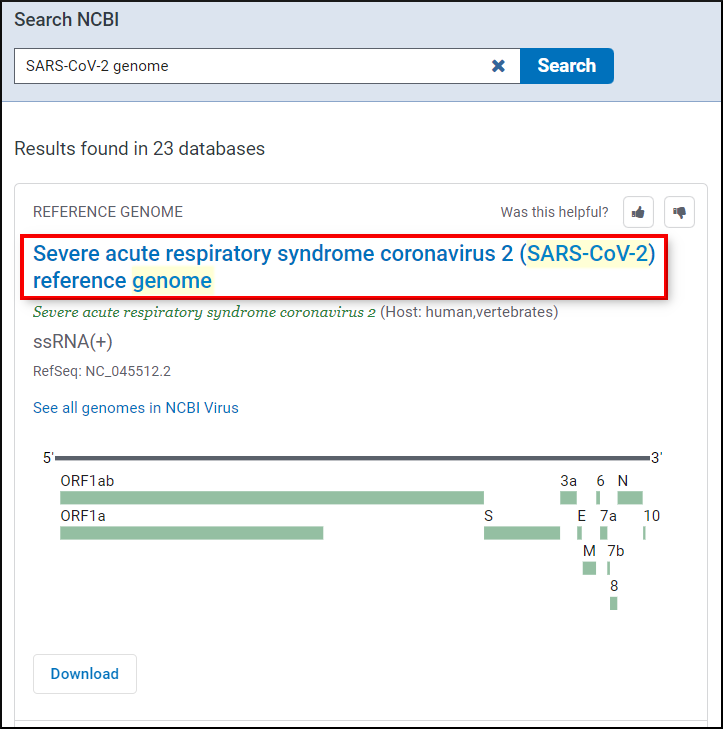  

The link on the result takes you to the nucleotide record for the genome sequence, [NC_045512.2](https://www.ncbi.nlm.nih.gov/nuccore/NC_045512.2).  

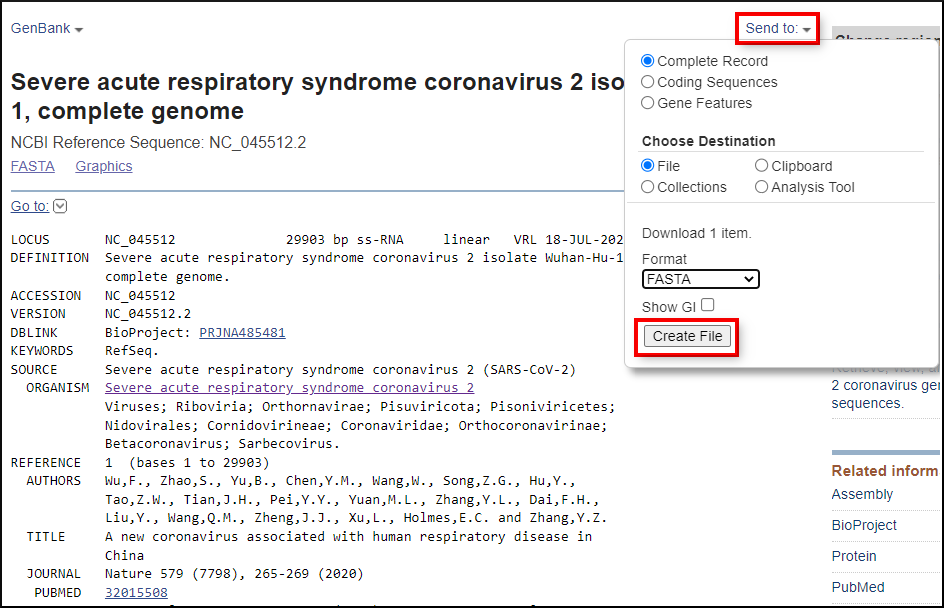  

You can easily download this sequence to your local computer from this webpage. However, it's more difficult to download from the web to your home directory on this Jupyter hub. To download, we'll use the [EDirect package](https://www.ncbi.nlm.nih.gov/books/NBK179288/) that provides command-line access to the many of the databases (PubMed, Nucleotide, Protein, etc.) at NCBI. The package is installed here. We'll cover using EDirect in detail in an upcoming workshop. We'll just be using the efetch program here to download the genome sequence.  
  
Run the command in the next cell to retrieve the SARS-CoV-2 reference and save it to a file on your home directory.

In [ ]:
efetch -db nuccore -id NC_045512.2 -format fasta > NC_0445512.fna
ls -l

The genome sequence you downloaded is based on an original December 2019 isolate from Wuhan, China.  
 ```  
 source          1..29903  
                     /organism="Severe acute respiratory syndrome coronavirus 2"  
                     /mol_type="genomic RNA"  
                     /isolate="Wuhan-Hu-1"  
                     /host="Homo sapiens"  
                     /db_xref="taxon:2697049"  
                     /country="China"  
                     /collection_date="Dec-2019"
```                     
The SARS-CoV-2 virus has evolved many variant lineages since then. We'll use MagicBLAST to align next-gen reads from a later isolate to this reference.  
  
### Step 2. Identifying other SARS-CoV-2 isolates




We can use the web interface to SRA to find samples from mid-2020 to compare to the reference. Search SRA for [2020/07[Publication Date] AND SARS-CoV-2[Organism] AND San Diego](https://www.ncbi.nlm.nih.gov/sra/?term=2020%2F07%5BPublication+Date%5D+AND+SARS-CoV-2%5BOrganism%5D+AND+San+Diego).  

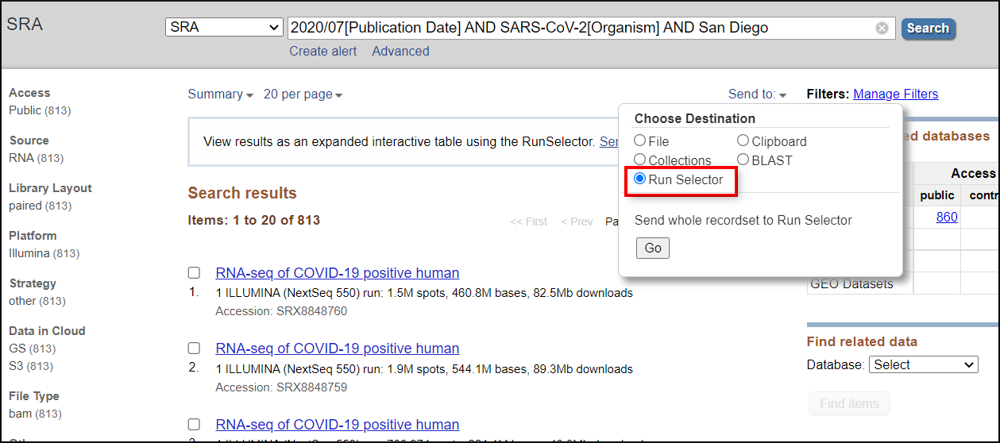  

Click the link at the top to "Send results to Run selector" and search within the results for 2020-06-23 collection date. We'll use [SRR12348966] as our run for the alignment.

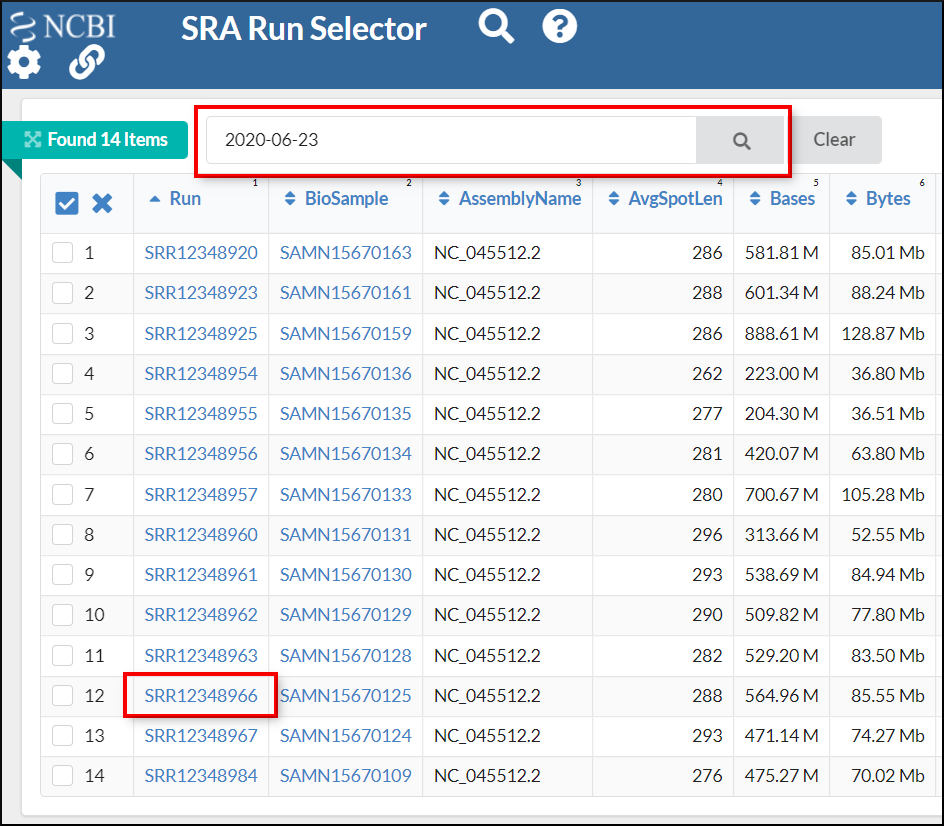

### Step 3. Making a BLAST database from the reference

We'll use makeblastdb to generate a BLAST database from the SARS-CoV-2 reference sequence. Run the following command-line to create the BLAST nucleotide database.

In [ ]:
makeblastdb -in NC_0445512.fna -dbtype nucl -parse_seqids -out NC_045512
ls -l | grep NC_045512

#### Step 4. Aligning the reads to the SARS-CoV-2 reference
We're now ready to align the reads to the genome. Since the reference here is a viral genome we don't need to worry about splicing or repeats. Notice that this experiment has paired reads. We'll first get the tabular output. Run the following commandline. 

In [ ]:
magicblast -sra SRR12348966 -db NC_045512 -splice F -limit_lookup F -no_unaligned -paired -num_threads 4 -outfmt tabular > SRR12348966_tab.out
ls -l | grep SRR12348966_tab.out

A popular format for next-gen alignments is SAM and the binary version BAM. Execute the following command output the MagicBLAST alignment in SAM format. 

In [ ]:
magicblast -sra SRR12348966 -db NC_045512 -splice F -limit_lookup F -paired -no_unaligned -num_threads 4 -outfmt sam > SRR12348966.sam
ls -l | grep SRR12348966.sam

### Step 5. Generating BAM and the BAM index for streaming in the NCBI grapical viewers
SAM/BAM format can be read by a number of bioinformatics tools. The [samtools](http://www.htslib.org/) package is essential for working with these formats (interconverting, sorting, indexing,dumping out regions, etc.). You can read more about how to use samtools and the various commands in [the manual](http://www.htslib.org/doc/samtools.html).    

Run the following command to generate a sorted BAM file.

In [ ]:
samtools view -bS SRR12348966.sam | samtools sort -o SRR12348966_sorted.bam -O BAM
ls -l | grep SRR12348966_sorted.bam

Run the following command to generate an index file for the BAM. The NCBI sequence viewer will use the index file when loadiing the BAM into the display.

In [ ]:
samtools index SRR12348966.bam SRR12348966_sorted.bam.bai
ls -l | grep SRR12348966_sorted.bam.bai

### Step 6. Loading the next-gen alignment into the graphical view of the SARS-CoV-2 reference genome
The BAM and BAM index files are on the [workshop directory on the FTP site](https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2022/NextGenMagicBlast_Dec/). You can load (stream) the remote BAM file as a track on the SARS-CoV-2 genome in the graphics view.  
Open the [graphical view of NC_045122](https://www.ncbi.nlm.nih.gov/nuccore/NC_045512.2?report=graph)  
- Use the Search feature to jump to position 23,403 of the genome before loading the remote file. 
- Open the "Tracks -> Configure tracks" menu (screeb shot below).  
- Choose the "Custom Data" tab.  
- Select "Remote Files."  
  
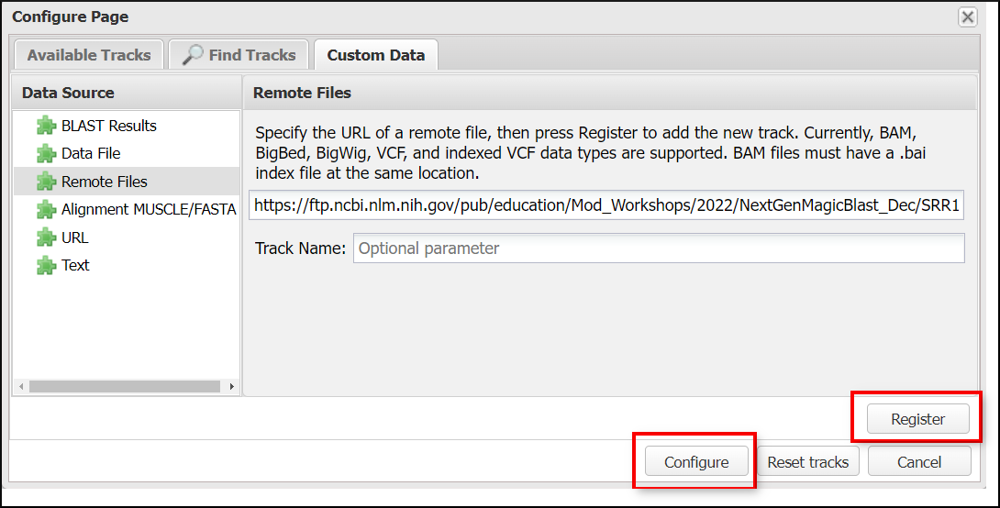  
- Copy and paste the following URL to the sorted BAM file into the box on the form
[https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2022/NextGenMagicBlast_Dec/SRR12348966_sorted.bam](https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2022/NextGenMagicBlast_Dec/SRR12348966_sorted.bam)  
- Click the "Register" button and wait for the track to register
- Click the "Configure" button.  
The track will load, but it may take a minute or so. Be patient. Your viewer should look like the screenshot below once the BAM loads completely. 
  
You should see that the aligned reads have a G base at this position compared to the reference A. This would change the aspartate residue in the spike protein to a glycine. This is one of the first major changes observed in the circulating SARS-CoV-2 virus. The lineage containing the glycine codon quickly out-competed the lineages with the aspartate codon here. All subsequent variants of concern have the glycine codon at this position.


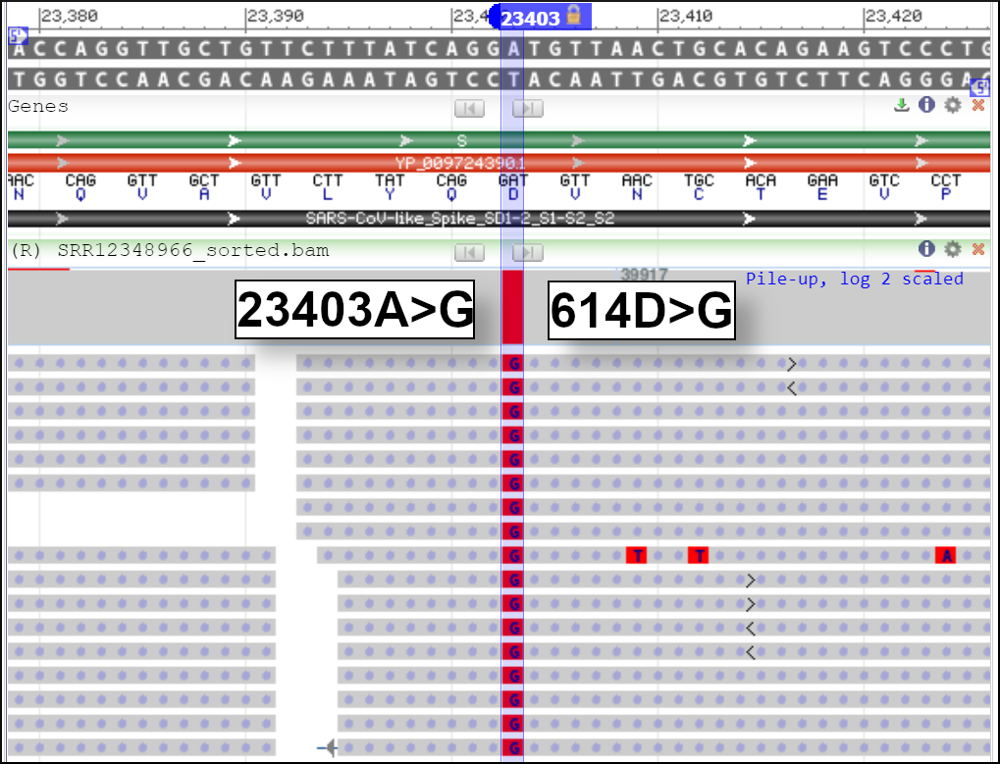

---
## Example 2 Finding expressed genes on a Fin Whale (_Balaenoptera physalus_) whole-genome shotgun sequence using the Blue Whale mRNA annotation <a class="anchor" id="Objective-2"></a>
### Step 1 Using BLAST to find a candidate contig containing the myoglobin gene to annotate  
- First we'll get the blue whale (_Balaenoptera musculus_) query sequence for myoglobin. The following command line will find and retrieve the sequence 

In [ ]:
esearch -db nuccore -query '"blue whale"[organism] AND mrna[filter] AND myoglobin[title] AND refseq[filter]' | \
efetch -format fasta > whale_mb.fna
head -100 whale_mb.fna

Next we'll need to identify the whole genome shotgun project for the Fin Whale (_Balaenoptera physalus_). We could do this using the Assembly database on the web. But we'll use a command line script (taxid2wgs.pl) that will allow us to find the WGS project and then use the blastn_vdb program that allows us to search WGS projects directly.  
- Let's use esearch and the taxonomy database to get the taxid for the Right Whale. We'll need this for the taxid2wgs script.

In [ ]:
esearch -db taxonomy -query 'Balaenoptera physalus' | efetch -format uid

- Now let's use taxid2wgs.pl to get the WGS project id. We simply give it the taxid and it will provide the WGS project(s) that are available for that taxid

In [ ]:
taxid2wgs.pl 9770

 There are two assemblies for the Fin Whale. We'll use the project JAHXJN01 in this examplet
 
 - We can now use blastn_vdb, which like MagicBLAST can access data over the internet from NCBI.  In this case we'll access the the WGS database and use the project as a BLAST database.  
 Simply use the WGS id as the argument for db.  The following command will find the the contig that contains the MB gene.

In [ ]:
blastn_vdb -query whale_mb.fna -db JAHXJN01 -outfmt 7 -num_threads 4

All of the hits are to one sequence, JAHXJN010000009.1, which we will use as the database for our MagicBLAST alignments. This is a 75 million base pair contig. We'll use only a 2 million basepair portion centered around the myoglobin match. We can specify -seq_start and -seq_stop in efetch to get the region we want.   
- As in the first example we'll use makeblastdb to generate a BLAST database.  We can save a step by piping the output of efetch directly to makeblastdb 

In [ ]:
efetch -db nuccore -format fasta -id JAHXJN010000009.1 -seq_start 63000000 -seq_stop 64000000 | \
makeblastdb -dbtype nucl -parse_seqids -out fin_whale_contig -title 'JAHXJN010000009.1 Fin Whale 2Mbp MB Contig'

### Step 2. Collection RefSeq mRNAs for the Blue Whale to align to the Fin Whale contig.   
The Gene database has information about the annotated genes for blue whale. To limit the scope of our search, we'll use only transcripts from chromosome 10 in the blue whale. Chromosome 10 is the location of the Blue Whale myoglobin gene and we should be able to annotate the closely related Fin Whale contig with these gene products.The following search in the Gene datanase will find protein coding genes on Blue Whale chromosome 10 ["blue whale"[organism] AND "genetype protein coding"[properties] AND 10[chromosome/]](https://www.ncbi.nlm.nih.gov/gene/?term=%22blue+whale%22%5BOrganism%5D+AND+%22genetype+protein+coding%22%5Bproperties%5D+AND+10%5Bchromosome%5D).  

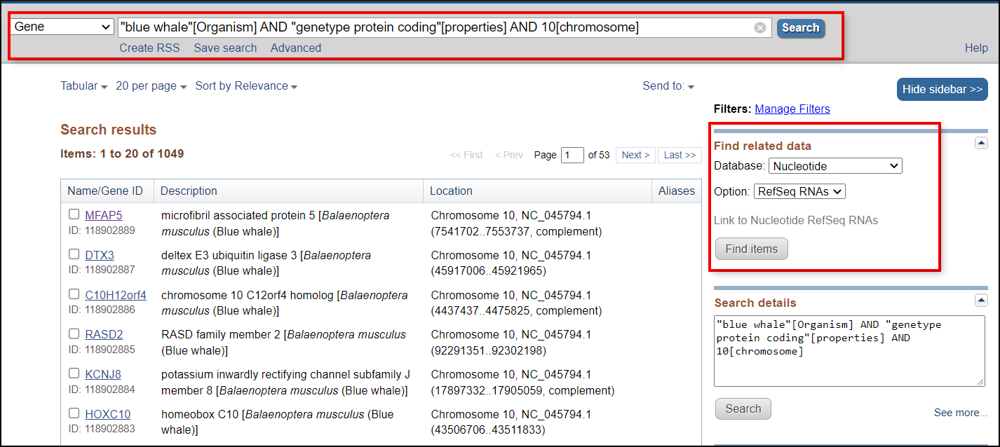

We can do the same search using EDirect's esearch. The following command will post the resulst of the search to the history server.

In [ ]:
esearch -db gene -query '"blue whale"[Organism] AND "genetype protein coding"[Properties] AND 10[chromosome]'

We can use these results to link to the the corresponding RefSeq transcripts in the nucleotide database.  Run the following command to get the set of RefSeq transcripts.

In [ ]:
esearch -db gene -query '"blue whale"[Organism] AND "genetype protein coding"[Properties] AND 10[chromosome]' | \
elink -target nuccore -name gene_nuccore_refseqrna | \
efetch -format fasta > blue_whale_rna.fna
head blue_whale_rna.fna

### Step 3. Aligining Blue Whale transcripts to the Fin Whale contig.

Run the following command to align the transcripts to the contig


In [ ]:
magicblast -query blue_whale_rna.fna  -infmt fasta -splice T -limit_lookup T -no_unaligned -perc_identity 96.0 -db fin_whale_contig -num_threads 4 -outfmt tabular -out blue_whale_fin_whale_out.tab
ls -l | grep blue_whale_fin_whale_out.tab

The MagicBLAST tabular output is described on the GitHub page. It's somewhat simpler than the SAM format and a little more human readable. Use the command below to dump out the tab format. Notice that the the accession number of the query sequence is in the first column. The position of the matches on the reference are in the 9th and 10th columns.

In [ ]:
#Getting a listing of the MagiBLAST output
cat blue_whale_fin_whale_out.tab

A shorthand rendering of the alignment called the BTOP string is in column 17.  Use the following to get the BTOP string for the myglobin alignments. The blue whale myoglobin accession is XM_036866958.1.

In [ ]:
#Examining the BTOP string for myglobin
grep XM_036866958.1 blue_whale_fin_whale_out.tab | cut -f 17

The BTOP string shows the following information:
- a number represents a number of matches
- two bases represent a mismatch and show query and reference base
- base and gap or gap and base, show a gap in query or reference
- ^\<number>^ represents an intron of this number of bases
- \_\<number>_ represents an insertion (gap in reference) of this number of bases
- %\<number>% represents a deletion (gap in read) of this number of bases
- (\<number>) shows number of query bases that are shared between two parts of a spliced alignment; used when proper splice sites were not found  

 4CT76GC15GC69%5610%222^gt3435ag^46GC177TC120GA144CG13TC54CA46TC23TC58  

In this case the string shows three distinct regions of matches (three exons) with some mismatches, interrupted by two introns. The second intron has a consensus splice site at either end. This is consistent with the structure of other myglobin genes.  

We can sort the ouput on the subject start position using the Unix sort utility and output the accessions and their positions on the contg. Note: The grep command at the beginning removes the header comment lines from the output before sorting.

In [ ]:
#Sorting by position and listing matches by position on the contig
grep -v '^#' blue_whale_fin_whale_out.tab | sort -k 9 -n | cut -f 1,9,10


Finally, we can submit each of the accessions in order to efetch to get the names of the gene products. (There are more elegant ways of dong this that we will cover in an upcoming workshop on EDirect.)

In [ ]:
#Using efetch to get gene product name
grep -v '^#' blue_whale_fin_whale_out.tab | sort -k 9 -n | cut -f 1 | \
while IFS= read -r line; do
    efetch -db nuccore -id "$line" -format fasta | grep '>'
done

As expected, this gene order matches that on the blue whale chromosome 10.

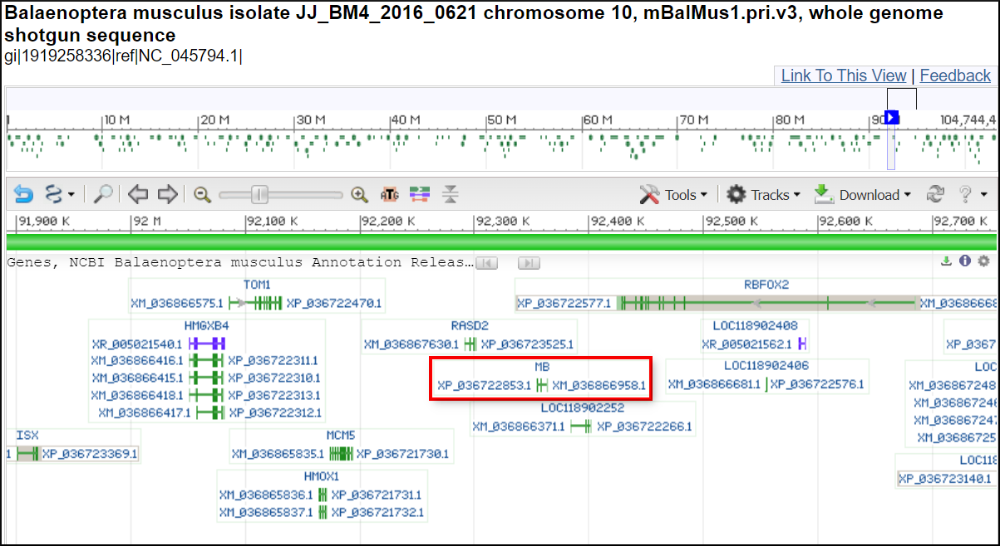


---
## On your own examples  

### Practice Example 1. Aligning reads to the ebola virus genome.  

Ebola virus Reference genome sequence: NC_002549  
Ebola virus next-gen reads: SRR1553459



In [ ]:
#Use efetch to retrieve the genome sequence.

In [ ]:
#Use makeblastdb to format the genome as a BLAST database.

In [ ]:
#Use magicblast to align the reads. Output a sam file SRR1553459.sam

In [ ]:
#Use samtools to generate a sorted BAM file SRR1553459_sorted.bam

In [ ]:
#Use samtools to create a BAM index file SRR1553459_sorted.bam.bai

Both the sorted BAM and BAM index are on the FTP site. Load the [graphics view of NC_002549](https://www.ncbi.nlm.nih.gov/nuccore/NC_002549.1?report=graph) and add the remote BAM file using  

https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2022/NextGenMagicBlast_Dec/SRR1553459_sorted.bam

## Practice Example 2. Annotating the Blue Whale tumor necrosis factor (TNF) gene region on the N. Pacific Right Whale (_Eubalaena japonica_)  



In [8]:
# Use esearch and efetch to download the Blue Whale TNF mRNA as whale_tnf.fna
# Use TNF[gene] AND blue whale[organism] AND mrna[filter] AND refseq[filter] as a query.

In [ ]:
# Use esearch and efetch to get the taxonomy id for Eubalaena japonica.

In [ ]:
# Use taxid2wgs.pl to get the WGS project ID.

In [ ]:
# Use blastn_vdb and the Right Whale TNF mRNA (whale_tnf.fna) to find an E. japonica contig with the TNF gene. 

In [ ]:
#Use efetch and makeblastdb to generate a BLAST database from the Eubalaena japonica contig found above. 
#Note: This contig is only 167Kb, so you can download the whole thing.

In [ ]:
#Use esearch, elink, and efetch to get the protein coding gene transcripts from Blue Whale chromosome 11
# Save as blue_whale_chr11_mrna.fna.
#TNF is on Blue Whale chromosome 11.

In [ ]:
#Use magicblast to align the transcripts to the Eubalaena japonica contig.

In [ ]:
#Use Unix utilities to sort the output and print out the accessions for the transcript matches.

In [ ]:
#Use Unix utilities and efetch to print out the gene products in order.

**Answers available [here](https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2022/NextGenMagicBlast_Dec/magicblast_pt1_exercises_answers.txt).**

---

## Objective 3 - Align RNAseq data to reference and visualize transcript coverage and diversity <a class="anchor" id="Objective-3"></a>

**Case Study for Objective 3**: Lamin-A Gene Mutations/Splice Variants and their role in diseases 

### **Objective Goals**

* Identify an RNAseq SRA dataset of interest in the Gene Expression Omnibus
* Use magic-BLAST to align SRA dataset to a reference. 
* Learn how to upload a remote file to GDV. 
* Use the Genome Data Viewer to compare RNAseq alignment to NCBI annotation tracks.

## Overview: 
* Hutchinson-Gilford progeria syndrome (HGPS) is a rare genetic disorder phenotypically characterized by many features of premature aging. 
* Mutations causing HGPS have been identified in the nuclear lamin A/C (LMNA) gene. Out of 14 mutations affecting lamin A/C, three have been reported to specifically alter lamin A splicing.Most are due to a recurrent, de novo point mutation in LMNA exon 11: c.1824C>T. This mutation occurs in a probable exon splicing enhancer. As a result, a cryptic splice site is activated in transcripts generated from the mutated allele, which is located 5 nucleotides upstream of the mutation.
*  The use of the cryptic splice site leads to the production of a truncated Lamin A protein lacking the last 150 base pairs of exon 11. The truncated protein is called “progerin” and acts in a dominant fashion to generate the HGPS phenotype.
* LMNA gene mutations also cause a number of diseases, so could be a really interesting genomic region to study: https://www.omim.org/entry/150330

### **Goal 3a: Identify an RNAseq SRA dataset of interest**


We are going to be getting NGS data generated by a publication: https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0205878

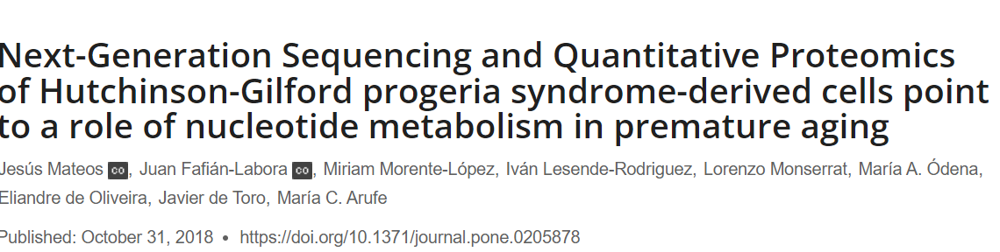

To quote this paper: 

> Although the causal agent, a point mutation in LMNA gene, was identified more than a decade ago, the molecular mechanisms underlying HGPS are still not fully understood and, currently, there is no cure for the patients, which die at a mean age of thirteen. With the aim of unraveling non-previously altered molecular pathways in the premature aging process, **human cell lines from HGPS patients and from healthy parental controls were studied in parallel using Next-Generation Sequencing (RNAseq) and High-Resolution Quantitative Proteomics (iTRAQ) techniques**



**Step 1: Find identifying information for a dataset** 

Luckily for us, scrolling down to the Results section, we can see that the authors have linked to their study data on the NCBI Gene Expression Omnibus (GEO) under accession number GSE113648: 

>Raw files are public and freely accessible (www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE113648). A total of 21872 transcripts were detected and quantified in both conditions (Control and HGPS) by NGS following our approach (S1 File and Fig 2A).

Click the link in the quoted text to take a look at the study on GEO!

**Step 2: Get SRA Run info from chosen study** 

    A. Find the link to the SRA Run Selector 

While there is a lot of useful information on this webpage about the study. For today, we are going to simply scroll right to the bottom of the page and find the link directly to the `SRA Run Selector` table for this study: 

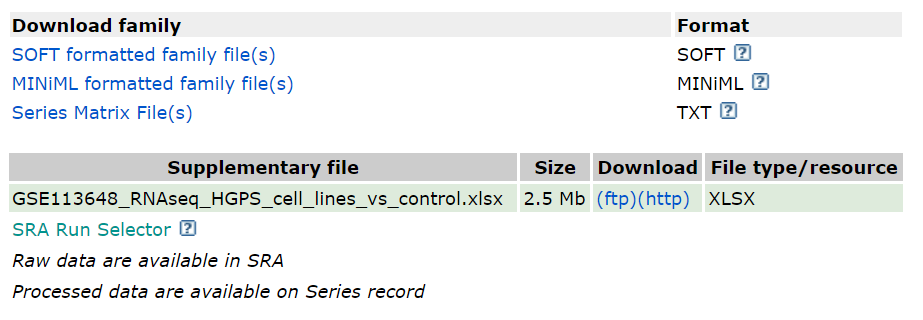

Clicking this link will take you to the SRA Run page for the BioProject corresponding to this GEO dataset: https://www.ncbi.nlm.nih.gov/Traces/study/?acc=PRJNA453535&o=acc_s%3Aa

    Step B:  Look at the SRA Run Selector

Once again, we could spend a while looking at this webpage, but for the purposes of this study, we are interested in the table at the bottom, that gives us information about each SRA run under this BioProject. Notably it is easy to see which samples have the progeria diease genotype (HGPS), and which ones are : 

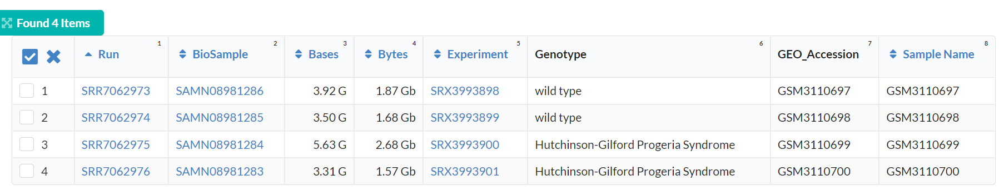

For the purposes of our study today we are going to pick the first Wild Type Sample, `SRR7062973`, and the first with Hutchinson-Gilford Progeria Syndrome, `SRR7062975`. 

### **Goal 3b: Use magic-BLAST to align chosen SRAs to reference sequence**

Above, we identified two RNAseq SRA data sets we would like to map to the region of the human genome containing the LMNA gene: SRR7062973 (our control sample), and SRR7062975 (our HGPS sample). 

**Step 1: Download the region of the current human genome assembly containing the LMNA gene**

Looking at the Gene Page for the LMNA gene, we can see that the LMNA gene occupies base pairs 156082573 to 156140081 on Human Chromosome 1. Because we want to learn about the genes in the surrounding region as well, we are going to extract the entire Human Chromosome 1 into a FASTA file. The following `efetch` command will extract the sequence for Human Chromosome 1 into a FASTA-formatted file. 

In [6]:
efetch -db nuccore -id NC_000001 -format fasta > Human_Chromosome1.fasta

This command will not report that it is done, but in a few seconds, the file `Human_Chromosome1.fasta` should appear amongst the list of files in your left panel: 


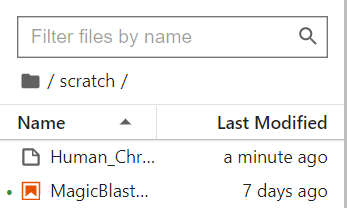


We can also use a Bash `head` command to confirm that this is a FASTA-formatted file:  

In [ ]:
head -n 5 Human_Chromosome1.fasta

**Step 2: Create LMNA region BLAST database**

Now that we have the region downloaded in FASTA format, we can use the BLAST utility `makeblastdb` to create a BLAST-formatted database from the file, using the following command. This command should produce text output that begins with `Building a new DB...` nearly immediately, and you should see 10 files appear in your left panel. These files are all parts of the Blast database we just created. 

In [ ]:
makeblastdb -in Human_Chromosome1.fasta -out Human_Chromosome1 -parse_seqids -dbtype nucl

**Step 3: Run magic-BLAST! Or, really, I will run it for us...**

Now that we have identified the SRA numbers of the sequencing runs we are interested in, and created a BLAST database for Human Chromosome 1, we are ready to use magic-BLAST! In reality, these are commands would take up to three hours to run, even with multiple processors. 

So, I have run the following commands for us on a computing cluster, and placed them on an FTP server. I will later be showing you how to stream the result files directly into GDV so we don't need to store the large result files anywhere locally: 

* **Step 3a: Run magic-BLAST and convert results to BAM for the control sample:**

You **DO NOT** need to run these commands!  

In [ ]:
# DO NOT RUN THIS COMMAND
magicblast -sra SRR7062973 -db Human_Chromosome1 -num_threads 16 -no_unaligned -out Chr1_LMNA_SRR7062973.sam

In order to examine patterns of gene expression in GDV, we will want our output in a BAM file so they can be visualized as a Pileup track. Streaming a file into GDV via an FTP site requires there to be a BAM index file, a `.bai` file, in the same location as the BAM file itself, so we will convert the magic-BLAST SAM output to BAM, and then index it using the following commands. 

Again, you **DO NOT** need to run these commands!

In [ ]:
# DO NOT RUN THESE COMMANDS
samtools view -S -b Chr1_LMNA_SRR7062973.sam > Chr1_LMNA_SRR7062973.bam
samtools sort Chr1_LMNA_SRR7062973.bam -o Chr1_LMNA_SRR7062973.sorted.bam
samtools index Chr1_LMNA_SRR7062973.sorted.bam

* **Step 3b: Run magic-BLAST and convert results to BAM for the HGSP sample:**

You **DO NOT** need to run these commands! 



In [ ]:
# DO NOT RUN THIS COMMAND
magicblast -sra SRR7062975 -db Human_Chromosome1 -num_threads 16 -no_unaligned -out Chr1_LMNA_SRR7062975.sam

As mentioned before, I have already placed the relevant sorted BAM files and their indices on an NCBI FTP site, so they are all ready to go!

### **Goal 3c: Load magic-BLAST results into GDV from a remote source**

**Step 1: Opening GDV onto Chromosome 1**

Let's all navigate to NCBI's Genome Data Viewer: https://www.ncbi.nlm.nih.gov/genome/gdv/. Because we are focusing on Chromosome 1, we will want to open a fresh GDV window focusing just on Chromosome 1. We can go straight to this chromosome by typing "chr1" into the "Search in Genome Box", while leaving the species and Assembly as-is, then press the search button: 

<div>
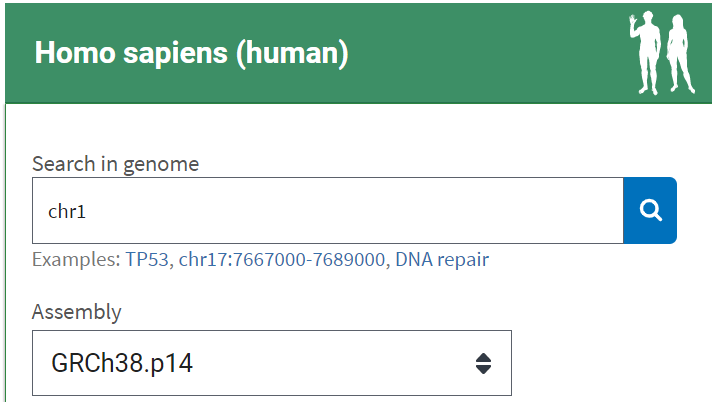
</div>

A GDV instance with Human Chromosome 1 (accession: NC_000001.11) should appear within a few seconds. While the following image is for Chromosome 19 rather than our Chromosome 1, it has all of the same pieces: 

<div>
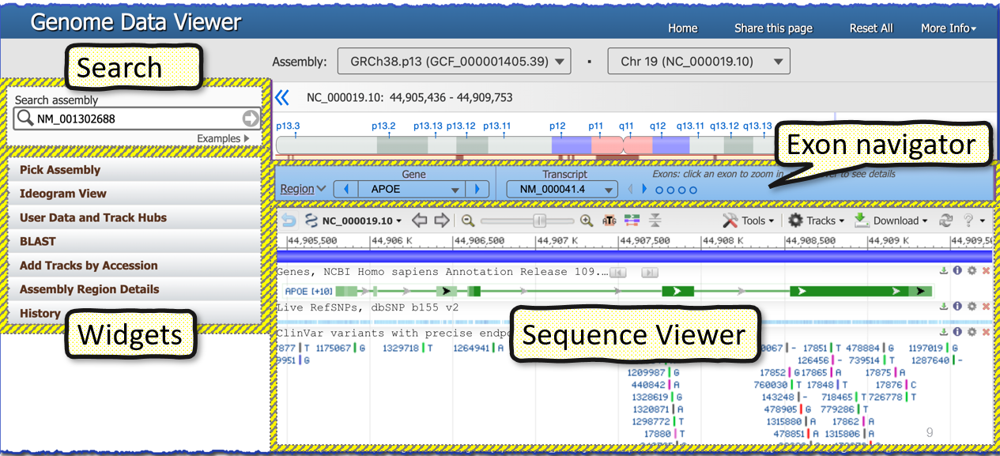
</div>

To reduce clutter while we load our own data, I like to close out all of the tracks besides the main sequence track and the NCBI Genes Annotation track by clicking the red X's in the corner of each track. This should result in a view that looks similar to this: 

<div>
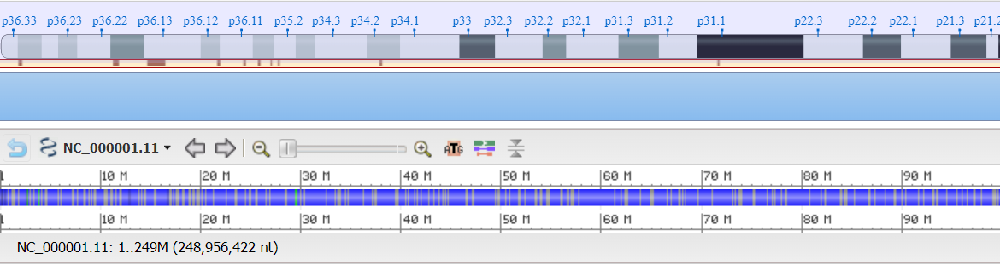
</div>

**Step 2: Add remote BAM file for control sample** 

One of the nicest features of GDV is accessing large, remote alignment files for visualization quickly and without actually needing to transfer these files locally or to GDV itself. Note that different file types can be accepted for Remote File access as compared with local upload: 


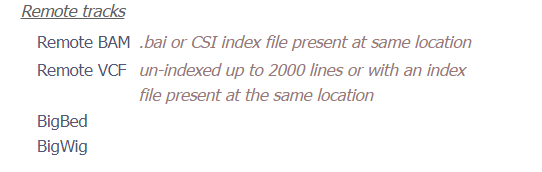

To do so, we are going back to the **Tracks and User Data** pane (in the Widgets menu), but this time selecting `Add Remote File`: 

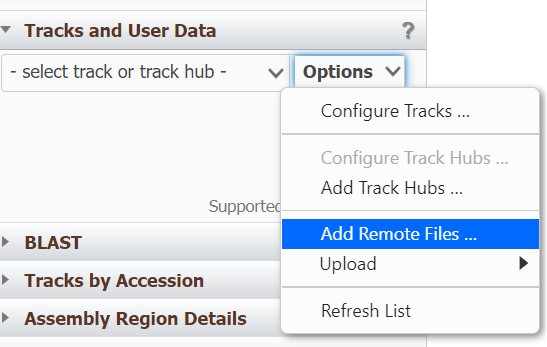

**Info for uploading:**

A upload window should appear, with a space to type in a URL where the remote file is stored. In this window, enter the following information: 

**URL:** https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2022/NextGenMagicBlast_Dec/Chr1_LMNA_SRR7062973.sorted.bam

**Name:** WT_Skin_Fibroblast

The track will be loaded in quite quickly, and you will be able to tell in a number of ways. First, in the `Tracks and User Data Pane` a green checkbox with an `Track(s) Add` confirmation will appear: 

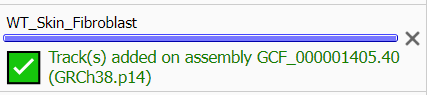

You will also see the track itself appear in the browser window. Note that BAM files are generally represented in GDV as Coverage data that has been log-2-scaled, rather than defaulting to a feature-focused view: 


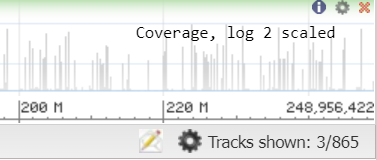

**On your own, upload the following `HGPS` genotype dataset to GDV:** 

**URL**: https://ftp.ncbi.nlm.nih.gov/pub/education/Mod_Workshops/2022/NextGenMagicBlast_Dec/Chr1_LMNA_SRR7062975.sorted.bam

**Name**: HGPS_Skin_Fibroblast

### **Goal 3d: Look at overall expression patterns in the LMNA gene and compare with NCBI annotation tracks**

**Step 1: Focus on LMNA Gene** 

Uh oh! We see an alert towards the top of our GDV browser window saying that there are too many genes in the region! No problem - in the `Search Assembly` window,  type in `LMNA`, and search. 

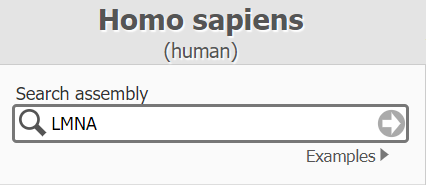

**Step 2: Add NCBI Gene Track**

In order to better keep track of the LMNA gene location as we navigate, let's add a track of data specifying the location of genes annotated in this version of the human genome. Since this is a very commonly used layer of information, we can find it under `NCBI Recommended Track Sets` under the `Tracks` menu. 

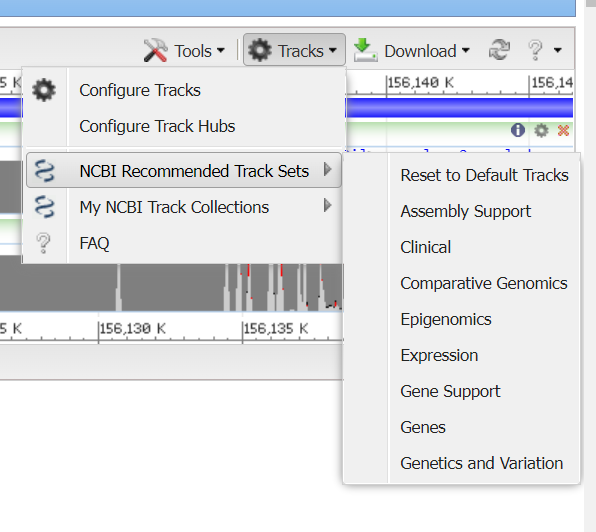

After selecting this track, your view should now look something like this: 

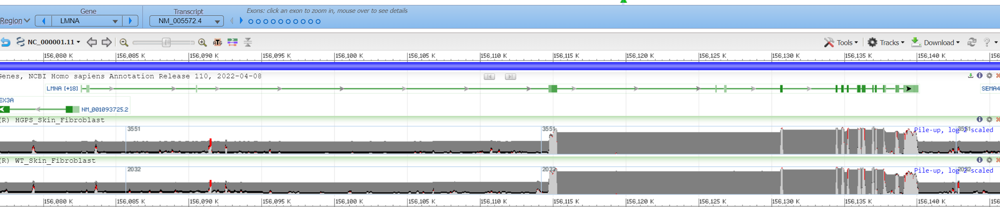

**Note about viewing alignments on GDV:**

Depending on the type of track, there are different options for how your data will be displayed. There are some several options for an Alignment Track (such as a BAM), set by changing the Alignment Display options: 

* **Adaptive (default)**:  Alignment data is represented differently at different zoom levels.
* **Packed**: Always shows the coverage or pile-up view
* **Ladder**: One alignment per row 
* **Show all**: Always shows individual alignments.

These can be accessed by going to `Tracks -> Configure Tracks -> Available Tracks`. 

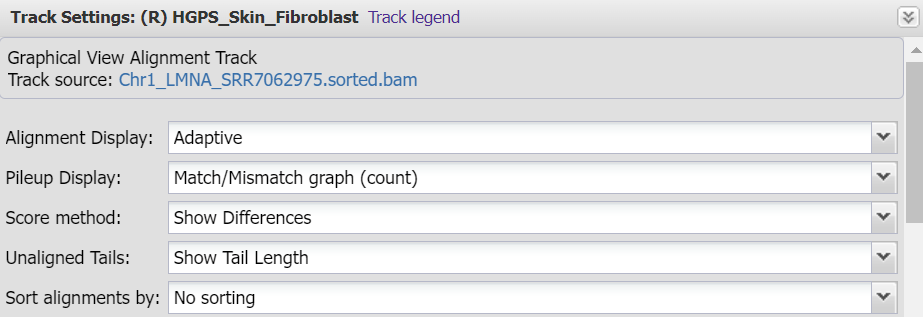



#### Pause for a question: Does the LMNA gene look differentially expressed to you? Is this expected? 

**Answer**: No, the authors did NOT find that this gene was significantly differentially expressed (will attach actual data for the real workshop). Remember, though, that we can keep looking at splice variation...




**Step 4: Examine a region of the LMNA gene with different expression patterns**

We are going to momentarily focus on a small difference expression just in one region of the LMNA gene between 156,110K bp and 156,115K bp on Chromosome 1. To keep track of this selection when we zoom in, we can place a marker over this whole region by dragging the cursor along the top bar, then using the Right Click menu option `Set New Marker on Selected Range`. If this works, your image should now look something like this, and there is a lot of information you can get by clicking on `Marker 1`: 

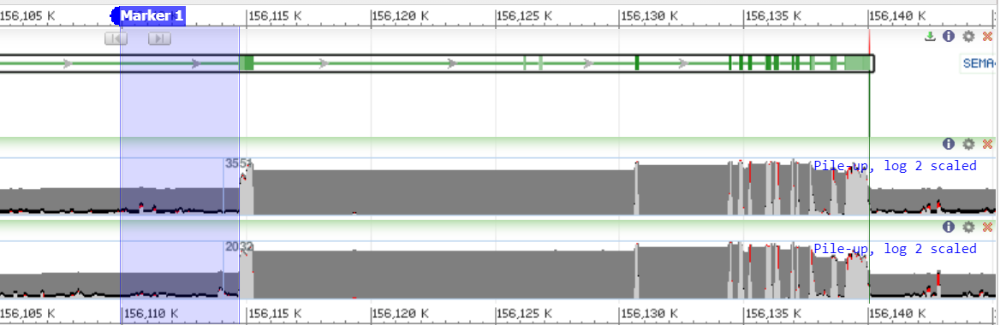

In [ ]:
Now that we have a handle on the region that 

Now we can continue to zoom in using the slider, 

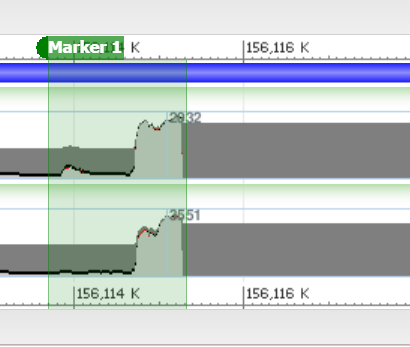

Wild Type Transcript Diversity: 


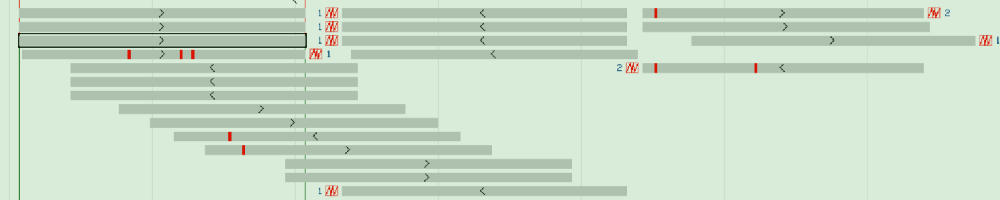

HGPS Transcript Diversity: 

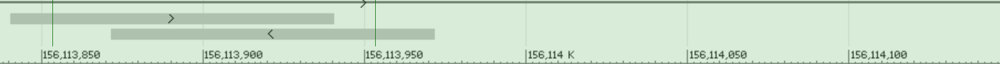

### Step 5: Examine expression patterns in LMNA Exon 11

**Topics covered here:** 
* Choosing a different focal transcript that has all the exons sequenced
* Exon navigation 
* Looking at additonal tracks
* Adding SNP/sequence variation tracks 


### Student Practice Example 

There ARE a number of genes on Chromosome 1 whose expression is statistically different between Wild Type and progeria patient cell lines. We will have students: 
* Practice finding a gene by name 
* Navigating to a particular chromosomes
* Are there any known mutations there? 

In [ ]:
### Sharing and Exporting Your View With GDV

---

## END OF OBJECTIVES! ##

---

## Conclusions <a class="anchor" id="Conclusions"></a>


## Advanced Materials and Further Resources